# Project Goal
I wanted to get my hands dirty with an industry standard toolbox for 2-photon image analysis and work with real data. Through this, I hope to show my proficiency with image analysis and Python programming along with my willingness to approach problems head-on. I springboarded off of the official [CaImAn documentation](https://github.com/flatironinstitute/CaImAn.git) to perform this analysis, but adapted much of their code for my purposes.

In [1]:
import imageio.v2 as imageio
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
from bokeh.io import output_notebook

In [2]:
import caiman as cm
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import cnmf, params
from caiman.utils.utils import download_demo
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
from visualization import nb_view_quilt

In [ ]:
output_notebook()

# Dataset Description
This data was collected using a 2-photon microscope  (B-scope; Thorlabs, USA). It shows GCaMP6f expression from the Retrosplenial cortex (RSC) of 5 animals over 7 days. In this study, I will be working with data from the 7th day. The animal of interest was not indicated in the dataset's description.
[Sun, Weilun (2021), “In vivo two-photon calcium imaging dataset_Day 7”, Mendeley Data, V1, doi: 10.17632/hjgtsmyyv5.1](https://data.mendeley.com/datasets/hjgtsmyyv5/1)

In [128]:
num_animals = 5
num_frames = 1000

In [129]:
def build_image_dict(num_animals, num_frames): 
    """Creates dictionary of images.
    
    Args:
        num_animals (int) : The number of animals to analyze.
        num_frames (int) : The number of frames to use for analysis.
        
    Returns:
        dict : Dictionary whose keys reference different animals (str) and 
            values are (num_frames, 256, 256) arrays.
    """
    image_dict = {}
    for i in range(1, num_animals + 1):
        path_name = f"./Animal_{i}"
        input_path = Path(path_name)
        image_list = sorted(input_path.glob("*.tif"))
        images = []
        for im_path in tqdm(image_list[:num_frames]):
            images.append(imageio.imread(im_path))
        # Reshape into (Time x Height x Width).
        image_dict[f"Animal_{i}"] = np.dstack(images).reshape(-1, 256, 256)

    return image_dict

image_dict = build_image_dict(num_animals, num_frames)

100%|██████████████████████████████████████| 1000/1000 [00:04<00:00, 247.32it/s]


In [130]:
def write_movie(image_dict):   
    """Creates movie from image data for better compatibility with CaImAn.
    
    Args:
        image_dict (dict) : Dictionary whose keys reference different animals (str) and 
            values are (num_frames, 256, 256) arrays.
        
    Returns:
        None
    """
    for animal in tqdm(image_dict.keys()):
        print(f"Writing {animal}_movie.tif...")
        imageio.mimwrite(f'{animal}_movie.tif', image_dict[animal], format='TIFF')

write_movie(image_dict)

  0%|                                                     | 0/5 [00:00<?, ?it/s]

Writing Animal_1_movie.tif...


 20%|█████████                                    | 1/5 [00:00<00:00,  4.27it/s]

Writing Animal_2_movie.tif...


 40%|██████████████████                           | 2/5 [00:00<00:00,  4.42it/s]

Writing Animal_3_movie.tif...


 60%|███████████████████████████                  | 3/5 [00:00<00:00,  4.30it/s]

Writing Animal_4_movie.tif...


 80%|████████████████████████████████████         | 4/5 [00:00<00:00,  4.40it/s]

Writing Animal_5_movie.tif...


100%|█████████████████████████████████████████████| 5/5 [00:01<00:00,  4.37it/s]


## Computing Baseline Data
- **Max Projection**: Looking at the maximum pixel intensities at each frame can generally indicate which neurons are activated at a given moment. However, before motion correction, these maximum intensity projections can be misleading due to motion artifacts. If the sample shifts between frames, the same neuron may appear in slightly different locations over time, causing blurring or spreading of high-intensity signals across multiple pixels. This results in a less distinct and noisier max projection image.
- **Local Correlations**: Local correlations are a measure of how well pixel intensities in neighboring regions of the image correlate over time. Before motion correction, this measure can be distorted by motion artifacts because moving neurons may cause nearby pixels to show temporal patterns that are not related to the same underlying neuronal activity. For example, a neuron might shift in position from one frame to the next, making its signal appear to "spread out" or correlate with adjacent pixels that don't actually share the same temporal dynamics.

## Expectations After Motion Correction
After motion correction with the **NoRMCorre** algorithm, I expect to see: 
- **Max Projection**: A sharper, more defined max projection image, indicating that neuron locations have been stabilized across frames and that neuronal structures are more accurately represented without being smeared by motion-induced displacement.
- **Local Correlations**: Reduced impact of false temporal correlations between pixels that are actually just displaced versions of the same neuron. After motion correction, pixels from neighboring regions should more accurately represent the same neural events over time, resulting in more reliable and precise local correlation maps. 

In [131]:
def get_baseline_movie_data(image_dict):
    """Gets baseline data from movies.
    
    Args:
        image_dict (dict) : Dictionary whose keys reference different animals (str) and 
            values are (num_frames, 256, 256) arrays.
        
    Returns:
        dict : Dictionary with same keys as image_dict whose values are (256, 256) arrays
            representing maximum fluorescence per pixel.
        dict : Dictionary with same keys as image_dict whose values are (256, 256) arrays 
            representing local correlations between neurons.
    """
    max_projection_dict = {}
    correlation_image_dict = {}
    for animal in tqdm(image_dict.keys()):
        # Load data and reshape to (Time x Height x Width).
        movie_orig = imageio.mimread(f"{animal}_movie.tif", memtest=False)
        movie_orig = np.dstack(movie_orig).reshape(-1, 256, 256)
        
        # Calculate maximum fluorescence.
        max_projection_dict[animal] = movie_orig.max(axis=0)
        
        # Calculate local correlation.
        correlation_image_dict[animal] = cm.local_correlations(movie_orig, swap_dim=False)
        
        # Replace NaNs with zero.
        correlation_image_dict[animal][np.isnan(correlation_image_dict[animal])] = 0 
        
    return max_projection_dict, correlation_image_dict

max_projection_dict, correlation_image_dict = get_baseline_movie_data(image_dict)

100%|█████████████████████████████████████████████| 5/5 [00:10<00:00,  2.14s/it]


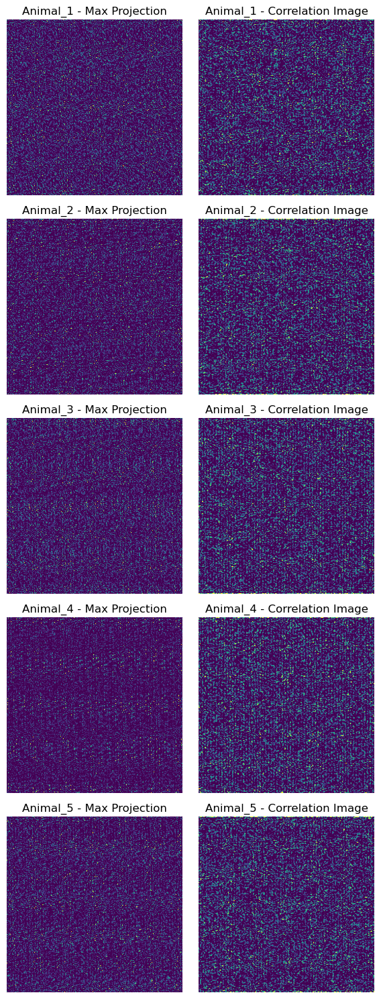

In [132]:
def plot_baseline_movie_data(max_projection_dict, correlation_image_dict):
    """Plots baseline data and sets a lower threshold for visualization values.
    
    Args:
        max_projection_dict (dict) : Dictionary with same keys as image_dict whose values are (256, 256) arrays
            representing the maximum fluorescence per pixel.
        correlation_image_dict (dict) : Dictionary with same keys as image_dict whose values are (256, 256) arrays 
            representing local correlations between neurons.
            
    Returns:
        None
    """
    fig, axes = plt.subplots(len(max_projection_dict), 2, figsize=(6, 3 * len(max_projection_dict)))
    
    if len(max_projection_dict) == 1:
        axes = [axes]

    for i, (animal, max_projection) in enumerate(max_projection_dict.items()):
        correlation_image = correlation_image_dict[animal]
        
        # Plot Max Projection.
        ax_max = axes[i][0]
        ax_max.imshow(max_projection, cmap='viridis',
                      vmin=np.percentile(max_projection.ravel(), 50), 
                      vmax=np.percentile(max_projection.ravel(), 99.5))
        ax_max.set_title(f"{animal} - Max Projection", fontsize=12)
        ax_max.axis("off")

        # Plot Correlation Image.
        ax_corr = axes[i][1]
        ax_corr.imshow(correlation_image, cmap='viridis',
                       vmin=np.percentile(correlation_image.ravel(), 50), 
                       vmax=np.percentile(correlation_image.ravel(), 99.5))
        ax_corr.set_title(f"{animal} - Correlation Image", fontsize=12)
        ax_corr.axis("off")

    # Adjust layout for better visualization.
    plt.tight_layout()
    plt.show()
    
plot_baseline_movie_data(max_projection_dict, correlation_image_dict)

## Analysis Parameters
### Dataset-Dependent Parameters
- **fr**: Imaging frame rate = 14.7 Hz 
- **decay_time**: Decay time of GCaMP6f = 0.4 s
- **dxy**: Spatial resolution per pixel in um = 300/256 um/pixel

### Motion Correction Parameters
- **strides**: Size of each region (patch) for piecewise rigid motion correction = (48, 48) pixels

- **overlaps**: Size of common region between patches: (24, 24) pixels

- **max_shifts**: Maximum shift-distance allowed for motion correction = (6, 6) pixels

- **max_deviation_rigid**: Maximum difference between patch shift and shift of whole image = 3 pixels

- **pw_rigid**: Enables algorithm to shift patches independently while maintaining a rigid transformation within each patch = True

### CNMF Parameters
- **p**: Order of model for for linearly dependent deconvolution = 1

- **gnb**: Number of background components for the algorithm to account for (i.e. fluroescence from tissue that is not actively being imaged) = 2

- **merge_thr**: Two components are merged if they have a correlation greater than this threshold as they are likely to be part of the same neuron = 0.85

- **bas_nonneg**: Prevents model from fitting negative_values because they would be biologically unrealistic = True

- **rf**: Sets patch size = 15

- **stride_cnmf**: Set to approximate size of neuron. Controls overlap between patches = 10

- **K**: Approximate number of components per patch. Lower values of K correspond to lower false-negative readings at the cost of efficiency = 4

- **gSig**: Set to roughly half the approximate size of a neuron. Parameter for Gaussian Blur = [4, 4]

- **gSiz**: uses gSig to calculate kernel size for Gaussian Blur

- **method_init**: Focuses the algorithm on the regions of interest with higher fluorescence to optimize efficiency = 'greedy_roi'

- **ssub**: Lower values correspond to higher resolution at the cost of efficiency = 1

- **tsub**: Controls downsampling of temporal resolution = 1

### Component Evaluation Parameters
- **min_SNR**: Minimum signal to noise ratio to accept a component = 2.0

- **rval_thr**: Threshold for spatial correlation between component and input data = 0.85

- **cnn_thr**: Threshold at the convolutional neural network accepts components = 0.99 

- **cnn_lowert**: Lowest probability for a component to be accepted by the convolutional neural network. Lowers chances of false-positive = 0.1

In [133]:
# Dataset Dependent Parameters
fr = 15
decay_time = 0.4
dxy = (300/256, 300/256)

# Motion Correction Parameters
strides = (48,48)
overlaps = (24, 24)
max_shifts = (6, 6)
max_deviation_rigid = 3
pw_rigid = True

# CNMF Parameters
p = 1
gnb = 2
merge_thr = 0.85
bas_nonneg = True
rf = 15
stride_cnmf = 10
K = 4
gSig = np.array([4, 4])
gSiz = 2*gSig + 1
method_init = 'greedy_roi'
ssub = 1
tsub = 1

# parameters for component evaluation
min_SNR = 2.0
rval_thr = 0.85
cnn_thr = 0.99
cnn_lowest = 0.1

In [134]:
def build_parameter_dict(num_animals):
    """Populates parameter dict for motion correction and CNMF.
    
    Args:
        num_animals (int) : Number of animals to analyze.
    
    Returns:
        dict : Same keys as image_dict with values containing parameters for motion correction and CNMF.
    """
    # Assuming animals are labeled as 1 - num_animals.
    animal_ids = range(1, num_animals + 1)
    
    parameters_dict = {}
    for animal_id in animal_ids:
        animal = f'Animal_{animal_id}'
        movie_path = f'{animal}_movie.tif'

        parameter_dict = {
            'fnames': movie_path,
            'fr': fr,
            'dxy': dxy,
            'decay_time': decay_time,
            'strides': strides,
            'overlaps': overlaps,
            'max_shifts': max_shifts,
            'max_deviation_rigid': max_deviation_rigid,
            'pw_rigid': pw_rigid,
            'p': p,
            'nb': gnb,
            'rf': rf,
            'K': K, 
            'gSig': gSig,
            'gSiz': gSiz,
            'stride': stride_cnmf,
            'method_init': method_init,
            'rolling_sum': True,
            'only_init': True,
            'ssub': ssub,
            'tsub': tsub,
            'merge_thr': merge_thr, 
            'bas_nonneg': bas_nonneg,
            'min_SNR': min_SNR,
            'rval_thr': rval_thr,
            'use_cnn': False,
            'min_cnn_thr': cnn_thr,
            'cnn_lowest': cnn_lowest,
        }

        parameters = params.CNMFParams(params_dict=parameter_dict)
        parameters_dict[animal] = parameters
        
    return parameters_dict

parameters_dict = build_parameter_dict(num_animals=num_animals)

## Motion Correction
### Why is Motion Correction Necessary?
Motion correction helps eliminate the effects of slight movement that may cause artificats in the image in order to maintain spatial consistency. This allows us to improve the signal to noise ratio in the data and accurately extract components in CNMF. Although measures like head-fixing and anesthetization are generally used to minimize movement and in turn artificats, motion correction is still necessary to more closely represent accurate calcium expression.
### Why local piecewise motion correction?
Although there are computational benefits to performing a global motion correction, applying motion correction transformations to local patches accounts for complex motion types that are more representative of living organisms as opposed to the more linear expectation of rigid motion correction, thus improving the alignment.

In [135]:
%%time
def build_motion_correct_dict(parameters_dict):
    """Populates dictionary with MotionCorrect objects.
    
    Args:
        parameter_dict (dict) : Dictionary with same keys as image_dict containing motion correction parameters
        
    Returns:
        dict : Dictionary with same keys as image_dict and values containing CaImAn MotionCorrect objects.
    """
    motion_correct_dict = {}
    for parameter in tqdm(parameters_dict.keys()):
        mot_correct = MotionCorrect(parameters_dict[parameter].data['fnames'][0], \
                                    **parameters_dict[parameter].motion)
        
        # Perform the motion correction and save memory mapped file.
        mot_correct.motion_correct(save_movie=True)  
        motion_correct_dict[parameter] = mot_correct
        
    return motion_correct_dict

motion_correct_dict = build_motion_correct_dict(parameters_dict)

100%|█████████████████████████████████████████████| 5/5 [04:21<00:00, 52.34s/it]

CPU times: user 3min 42s, sys: 33.3 s, total: 4min 15s
Wall time: 4min 21s


In [136]:
def load_motion_corrected_movies(motion_correct_dict):
    """Reads from MotionCorrect objects and loads memory mapped movies.
    
    Args:
        motion_correct_dict: Dictionary with same keys as image_dict containing MotionCorrect objects
        
    Returns:
        dict : Dictionary with same keys as motion_correct_dict whose values are (T x Height x Width) arrays
    """
    movie_motion_correct_dict = {}
    for movie in tqdm(motion_correct_dict.keys()): 
        # Load motion corrected movie.
        movie_motion_corrected = cm.load(motion_correct_dict[movie].mmap_file)
        
        # Set lower bound to 0 to handle negative outliers from background subtraction.
        movie_motion_corrected = np.clip(movie_motion_corrected, a_min=0, a_max=2**31-1)
        movie_motion_correct_dict[movie] = movie_motion_corrected
    
    return movie_motion_correct_dict

movie_motion_correct_dict = load_motion_corrected_movies(motion_correct_dict)

100%|█████████████████████████████████████████████| 5/5 [00:04<00:00,  1.17it/s]


## Motion Correction Comparison Study
See analysis below

In [137]:
# Calculate maximum fluorescence and local correlations for motion corrected data.
max_projection_mc_dict, correlation_image_mc_dict = get_baseline_movie_data(movie_motion_correct_dict)

100%|█████████████████████████████████████████████| 5/5 [00:11<00:00,  2.32s/it]


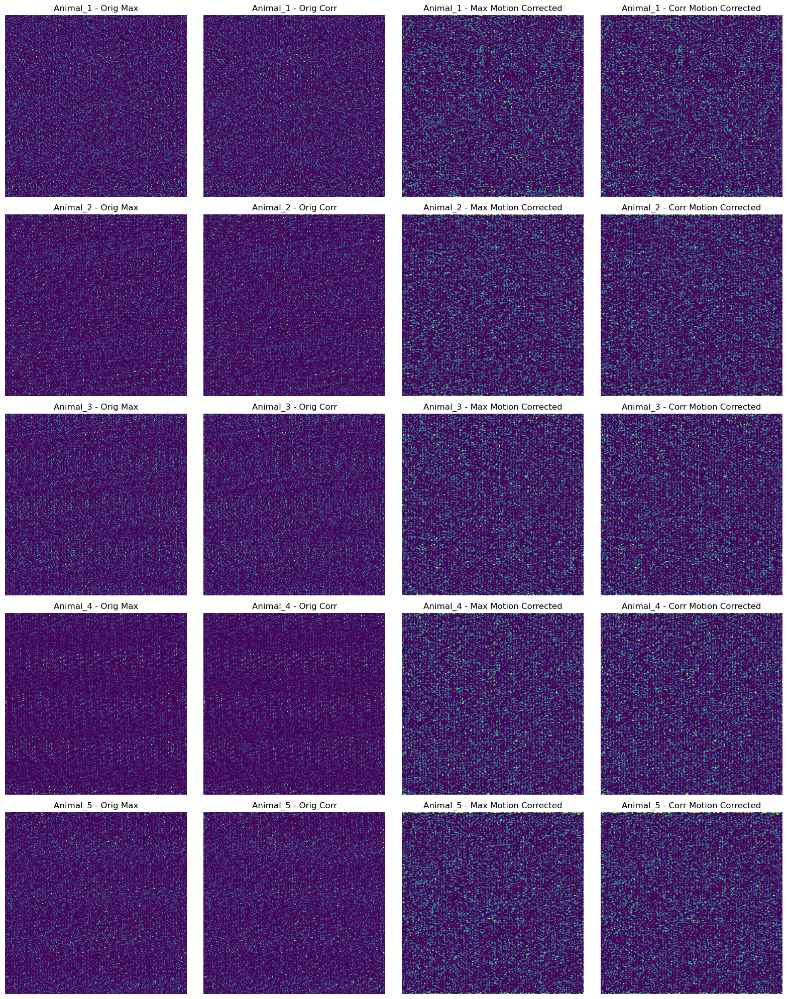

In [138]:
def compare_baseline_data(max_projection_dict, correlation_image_dict, \
                          max_projection_mc_dict, correlation_image_mc_dict):
    """Helper function to plot baseline data before and after motion correction.
    
    Args:
        max_projection_dict (dict) : Maximum pixelwise fluorescence before motion correction.
        correlation_image_dict (dict) : Local correlations before motion correction.
        max_projection_mc_dict (dict) : Maximum pixelwise fluorescence after motion correction.
        correlation_image_mc_dict (dict) : Local correlations after motion correction.
        
    Returns:
        None
    """
    fig, axes = plt.subplots(num_animals, 4, figsize=(16, 4 * num_animals))
    axes = np.atleast_2d(axes)

    for i, animal in enumerate(max_projection_dict.keys()):
        # Get data before motion correction.
        max_orig = max_projection_dict[animal]
        corr_orig = correlation_image_dict[animal]

        # Get motion corrected data.
        max_corr = max_projection_mc_dict[animal]
        corr_corr = correlation_image_mc_dict[animal]

        # Plot Original Max Projection
        ax = axes[i, 0]
        ax.imshow(max_orig, cmap='viridis', 
                  vmin=np.percentile(max_orig.ravel(), 50), 
                  vmax=np.percentile(max_orig.ravel(), 99.5))
        ax.set_title(f"{animal} - Orig Max", fontsize=12)
        ax.axis("off")

        # Plot Corrected Max Projection
        ax = axes[i, 1]
        ax.imshow(max_corr, cmap='viridis', 
                  vmin=np.percentile(max_corr.ravel(), 50), 
                  vmax=np.percentile(max_corr.ravel(), 99.5))
        ax.set_title(f"{animal} - Orig Corr", fontsize=12)
        ax.axis("off")

        # Plot Original Correlation Image
        ax = axes[i, 2]
        ax.imshow(corr_orig, cmap='viridis', 
                  vmin=np.percentile(corr_orig.ravel(), 50), 
                  vmax=np.percentile(corr_orig.ravel(), 99.5))
        ax.set_title(f"{animal} - Max Motion Corrected", fontsize=12)
        ax.axis("off")

        # Plot Corrected Correlation Image
        ax = axes[i, 3]
        ax.imshow(corr_corr, cmap='viridis', 
                  vmin=np.percentile(corr_corr.ravel(), 50), 
                  vmax=np.percentile(corr_corr.ravel(), 99.5))
        ax.set_title(f"{animal} - Corr Motion Corrected", fontsize=12)
        ax.axis("off")

    plt.tight_layout()
    plt.show()
    
compare_baseline_data(max_projection_dict, correlation_image_dict, \
                      max_projection_mc_dict, correlation_image_mc_dict)

## Motion Correction Comparison Study Analysis
Before motion correction, the image appears smoother and less detailed, with fluorescence signals appearing in transient, less defined bursts. This is likely due to the misalignment of frames, causing neural signals to blur across time and space. Additionally, motion artifacts may obscure finer structures, leading to a loss of spatial resolution and reducing the ability to distinguish individual components.

After motion correction, the image becomes significantly more granular indicating that fluorescence signals are more localized and well-defined. This suggests that neural activity is now more accurately captured, with individual neurons and their fluctuations more clearly aligned over time. The increased fluorescence intensity across the image indicates that signal integration is no longer disrupted by motion artifacts, leading to a more faithful representation of neural activity.

This improvement is significant because motion artifacts can obscure true neural signals, making it difficult to accurately track activity, quantify fluorescence changes, or extract meaningful neuronal dynamics. By enhancing spatial precision and preserving the integrity of fluorescence fluctuations, motion correction ensures that downstream analyses such as source extraction, spike inference,etc. are based on more reliable data.

## Constrained Non-Negative Matrix Factorization (CNMF)
Constrained Non-Negative Matrix Factorization, or CNMF, is often used for 2-photon image analysis. It operates by decomposing the fluorescence signals into spatial and temporal components that correspond to individual neuronal activity. 

Unlike PCA or ICA, CNMF handles the problem of overlapping neurons well by explicitly modeling the spatial overlap of neurons. By enforcing non-negativity, it further improves the robustness of the extracted signals, modeling true biological behavior. Additionally, it can build upon motion correction by identifying stable neural components, filtering out motion-induced changes in intensity. 

### What to expect from this data?
After performing CNMF on the 2-photon data, I expect to be able to visualize distinct spatial components corresponding to neurons. The algoritm should account for overlapping signals and return the isolated neurons accordingly. There should be very little background fluorescence due to CNMF's explicit separation of signals into their Spatial, Temporal, and Background components. Lastly, I hope to be able to isolate certain spikes in the neurons and attribute those spikes to specific function.

In [139]:
def build_cnmf_model_dict(parameters_dict):
    """Populates a dictionary with CNMF models.
    
    Args:
        parameters_dict (dict) : Dictionary with same keys as image_dict containing all CNMF modelling parameters.
        
    Returns:
        dict : Dictionary with same keys as parameters_dict whose values are CNMF models that will be fit to data.
    """
    cnmf_model_dict = {}
    
    for animal in tqdm(parameters_dict):
        cnmf_model = cnmf.CNMF(1,params=parameters_dict[animal])
        cnmf_model_dict[animal] = cnmf_model
        
    return cnmf_model_dict

cnmf_model_dict = build_cnmf_model_dict(parameters_dict)

100%|██████████████████████████████████████████| 5/5 [00:00<00:00, 15923.71it/s]


In [140]:
def build_processed_images_dict(motion_correct_dict):
    """Populates dictionary with motion corrected memory maps.
    
    Args:
        motion_correct_dict (dict) : Dictionary containing MotionCorrect objects.
        
    Returns:
        dict : Dictionary containing Time x Height x Width arrays for each movie.
    """
    processed_images_dict = {}
    for motion_corrected_movie in tqdm(motion_correct_dict):
        mc_memmapped_fname = cm.save_memmap(
            motion_correct_dict[motion_corrected_movie].mmap_file, 
            base_name='memmap_', 
            order='C',
            border_to_0=0
        )

        # Load the memmapped file.
        raw_calcium_traces, dims, num_frames = cm.load_memmap(mc_memmapped_fname)

        # Reshape into Time x Height x Width.
        images = np.reshape(raw_calcium_traces.T, [num_frames] + list(dims), order='F')
        
        processed_images_dict[motion_corrected_movie] = images
        
    return processed_images_dict

processed_images_dict = build_processed_images_dict(motion_correct_dict)

100%|█████████████████████████████████████████████| 5/5 [00:03<00:00,  1.58it/s]


In [141]:
%%time
def build_cnmf_dict(cnmf_model_dict, processed_images_dict, cnmf_refit_dict=None):
    """Fits or refines existing fits on processed images.
    
    Args:
        cnmf_model_dict (dict) : Dictionary containing CNMF models.
        processed_images_dict (dict) : Dictionary containing Time x Height x Width arrays for each movie.
        cnmf_refit_dict (Optional): If included, refines an initial fit.
        
    Returns:
        dict : Dictionary containing segmentation and component estimations.
    """
    cnmf_fit_dict = {}
    for animal in tqdm(processed_images_dict.keys()):
        # Perform refinement on initial fit if already computed.
        if cnmf_refit_dict is not None:
            cnmf_fit = cnmf_refit_dict[animal].refit(processed_images_dict[animal])
        else:
            cnmf_fit = cnmf_model_dict[animal].fit(processed_images_dict[animal])

        cnmf_fit_dict[animal] = cnmf_fit
        
    return cnmf_fit_dict

cnmf_fit_dict = build_cnmf_dict(cnmf_model_dict, processed_images_dict)

100%|█████████████████████████████████████████████| 5/5 [03:47<00:00, 45.48s/it]

CPU times: user 3min 21s, sys: 17.7 s, total: 3min 38s
Wall time: 3min 47s


## CNMF Initial Fit Visualization
The initial segmentation does not seem to have yielded the results I was looking for. There is significant overlap between neurons, and the signal to noise ratio seems to be relatively high, as seen in the plots below. The distribution of neurons must be more discrete in order for the signal separation to yield any significant results.

In [142]:
def plot_cnmf_contours(cnmf_fit_dict, correlation_image_mc_dict, evaluated=False):
    """Visualization function to view CNMF model segmentation and component estimations.
    
    Args:
        cnmf_fit_dict (dict) : Dictionary containing CNMF Models
        correlation_image_mc_dict (dict) : Dictionary containing motion corrected correlation images
        evaluted (Optional) = False: If True, shows accepted and rejected components based on evaluation metrics.
    
    Returns:
        None
    """
    for animal in tqdm(cnmf_fit_dict.keys()):
        cnmf_fit = cnmf_fit_dict[animal]
        correlation_image = correlation_image_mc_dict[animal]
        if evaluated:
            cnmf_fit.estimates.plot_contours_nb(img=correlation_image, \
                                                idx=cnmf_fit.estimates.idx_components)
        else:         
            cnmf_fit.estimates.plot_contours_nb(img=correlation_image)

plot_cnmf_contours(cnmf_fit_dict, correlation_image_mc_dict)

  0%|                                                     | 0/5 [00:00<?, ?it/s]

 20%|█████████                                    | 1/5 [00:00<00:02,  1.69it/s]

 40%|██████████████████                           | 2/5 [00:01<00:01,  1.62it/s]

 60%|███████████████████████████                  | 3/5 [00:01<00:01,  1.62it/s]

 80%|████████████████████████████████████         | 4/5 [00:02<00:00,  1.55it/s]

100%|█████████████████████████████████████████████| 5/5 [00:03<00:00,  1.56it/s]


## CNMF Re-Fit
To improve the accuracy of neural signal extraction, I performed a CNMF re-fit after the initial decomposition. The first pass can sometimes lead to overlapping components, missed low-amplitude signals, or insufficient separation of neural and background activity. Re-fitting allows for a more precise refinement of spatial components and calcium traces, enhancing signal quality and reducing background noise. This step ensures a more reliable representation of neural activity, improving the robustness of downstream analyses.

In [143]:
%%time
cnmf_refit_dict = build_cnmf_dict(cnmf_model_dict, processed_images_dict, cnmf_fit_dict)

100%|████████████████████████████████████████████| 5/5 [10:11<00:00, 122.31s/it]

CPU times: user 9min 56s, sys: 5.68 s, total: 10min 2s
Wall time: 10min 11s


In [144]:
plot_cnmf_contours(cnmf_refit_dict, correlation_image_mc_dict)

  0%|                                                     | 0/5 [00:00<?, ?it/s]

 20%|█████████                                    | 1/5 [00:00<00:02,  1.88it/s]

 40%|██████████████████                           | 2/5 [00:01<00:01,  1.91it/s]

 60%|███████████████████████████                  | 3/5 [00:01<00:01,  1.89it/s]

 80%|████████████████████████████████████         | 4/5 [00:02<00:00,  1.88it/s]

100%|█████████████████████████████████████████████| 5/5 [00:02<00:00,  1.87it/s]


In [145]:
for animal in cnmf_refit_dict.keys():
    print(f"{cnmf_refit_dict[animal].estimates.A.shape[1]} components found in {animal}.")

183 components found in Animal_1.
145 components found in Animal_2.
174 components found in Animal_3.
152 components found in Animal_4.
200 components found in Animal_5.


## Evaluation
While the CNMF approach showed promising results in terms of low false-positive readings across all animals, Animals 2, 3, and 4 presented challenges with very few identifiable components. The poor SNR in these cases was primarily due to low signal strength, making it difficult to distinguish neural activity from background noise, despite the low false-positive rate. In contrast, Animals 1 and 5 demonstrated more promising results with higher SNR, as they exhibited clearer and more discrete neuronal activity, enabling more reliable segmentation and separation of individual neurons.

Although I considered employing CNN-based algorithms for better signal discrimination, limited computational resources led me to prioritize the CNMF approach. This decision was made with the understanding that CNN models could significantly improve segmentation by more accurately distinguishing neural signals from noise in more complex data sets. 

In [2]:
def evaluate_components(processed_images_dict, cnmf_refit_dict):
    """Accepts or rejects detected components based on evaluation metric thresholds.
    
    Args:
        processed_images_dict (dict) : Dictionary containing Time x Height x Width arrays for each movie.
        cnmf_refit_dict (dict) : Dictionary containing refined segmentations and component estimates. 
        
    Returns:
        None
    """
    for animal in processed_images_dict.keys():
        processed_images = processed_images_dict[animal]
        cnmf_refit = cnmf_refit_dict[animal]
        cnmf_refit.estimates.evaluate_components(processed_images, cnmf_refit.params);
        print(f"Num accepted/rejected: {len(cnmf_refit.estimates.idx_components)}, {len(cnmf_refit.estimates.idx_components_bad)}")
        
evaluate_components(processed_images_dict, cnmf_refit_dict)


In [147]:
plot_cnmf_contours(cnmf_refit_dict, correlation_image_mc_dict, evaluated=True)

  0%|                                                     | 0/5 [00:00<?, ?it/s]

 20%|█████████                                    | 1/5 [00:00<00:02,  1.73it/s]

 40%|██████████████████                           | 2/5 [00:01<00:01,  1.60it/s]

 60%|███████████████████████████                  | 3/5 [00:02<00:01,  1.34it/s]

 80%|████████████████████████████████████         | 4/5 [00:02<00:00,  1.39it/s]

100%|█████████████████████████████████████████████| 5/5 [00:03<00:00,  1.42it/s]


## Segmentation vs Signal Extraction
Both segmentation and signal extraction are important aspects of 2-photon image analysis. My understanding of their difference is mainly in their scale and focus. Segmentation looks to identify possible regions of interest in the imaging field which involves grouping pixels that may belong to the same neuron, and in turn separating them from background fluorescence and overlapping signals. Signal extraction, on the other hand, works to isolate the fluorescence activity of each segmented neuron over time. This process converts the raw imaging data into time-series calcium signals which can then be analyzed in conjunction with segmented images to assess neural activity. 

A well segmented dataset ensures that the extracted signals accurately represent the neural activity of the subjects being imaged.

In [4]:
def plot_components(cnmf_refit_dict, correlation_image_mc_dict, bad_components=False):
    """Plots accepted or rejected components individually.
    
    Args:
        cnmf_refit_dict (dict) : Dictionary containing refined segmentations and component estimates. 
        correlation_image_mc_dict (dict): Dictionary containing motion corrected correlation images.
        bad_components (Optional) = False: If True, plots rejected components.
    """
    for animal in cnmf_refit_dict.keys():
        cnmf_refit = cnmf_refit_dict[animal]
        correlation_image = correlation_image_dict[animal]
        if bad_components:
            # View rejected components.
            if len(cnmf_refit.estimates.idx_components_bad) > 0:
                cnmf_refit.estimates.nb_view_components(img=correlation_image, 
                                                        idx=cnmf_refit.estimates.idx_components_bad, 
                                                        cmap='gray',
                                                        denoised_color='red')
            else:
                print("No components were rejected.")
        else:
            # View accepted components.
            cnmf_refit.estimates.nb_view_components(img=correlation_image, 
                                            idx=cnmf_refit.estimates.idx_components,
                                            cmap='gray');
            
plot_components(cnmf_refit_dict, correlation_image_mc_dict)

In [3]:
plot_components(cnmf_refit_dict, correlation_image_mc_dict, bad_components=True)

## Error Sources and Further Analysis
There are many unknowns with the dataset I chose. Although the conditions and specifications by which the animals were imaged are mentioned in the description of the data, the exact experimental conditions were not. Due to this, there can be many sources of error ranging from animal movement to fluorescence bleaching. 

There were also many assumptions I made about neuron size and imaging conditions that influenced my choice of parameters for motion correction and CNMF. If I were to perform this analysis again, I would hopefully have more specific information on the data collection setup and be able to utilize that information to perform a grid search over the parameters to optimize the final signal extraction.